In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from tqdm.auto import tqdm
tqdm.pandas()
os.getcwd()
artists = pd.read_csv('data/artists.csv', index_col=0)
df = pd.read_csv('data/main_dataset.csv', index_col=0)

In [2]:
import ast
import itertools
def flatten_list(input_list):
    return list(itertools.chain(*input_list))

def concat_flatlist(input_list):
    input_list = [i.replace(' ','') for i in input_list]
    return ' '.join(input_list)

df['artists_genres'] = df['artists_genres'].apply(ast.literal_eval)
df['artists_genres_flat'] = df['artists_genres'].apply(flatten_list).apply(concat_flatlist)


In [3]:
from sklearn.model_selection import train_test_split
df['playlist_uris'] = df['playlist_uris'].apply(ast.literal_eval)
playlists = df['playlist_uris'].explode()
playlists = list(set(playlists))

playlists_songs = pd.DataFrame(index= playlists, columns = ['songs'])

def get_playlist_songs(playlist):
    return df[df['playlist_uris'].apply(lambda x: playlist in x)].index.tolist()

playlists_songs['songs'] = playlists_songs.progress_apply(lambda x: get_playlist_songs(x.name), axis=1)

playlists_songs  = playlists_songs[playlists_songs.index!='']

# Assuming playlist_songs is a list of songs
train_songs, test_songs = train_test_split(playlists_songs, test_size=0.2, random_state=42)

# train_songs will contain 80% of the playlist_songs
# test_songs will contain the remaining 20% of the playlist_songs


  0%|          | 0/6071 [00:00<?, ?it/s]

In [4]:
import random

def create_test_set(test_songs: pd.DataFrame, n_test: int, n: int, m: int, min_m: int = 0, random_state: int = 42) -> tuple:
    """
    Create a test set by randomly selecting songs from playlists.

    Parameters:
    test_songs (pd.DataFrame): DataFrame containing the songs
    n_test (int): Number of test samples
    n (int): Number of songs in each sample

    Returns:
    list, list: X_test and y_test lists
    """
    random.seed(random_state)
    # Select random playlists from the dataframe
    random_playlists = random.choices(test_songs.index, k=n_test*2)

    X_test = []
    y_test = []
    i = 0
    for playlist_id in random_playlists:
        playlist_songs = test_songs.loc[playlist_id, 'songs']
        if len(playlist_songs) >= n+min_m:
            # Select n random songs from the playlist
            len_to_extract = min(n+m, len(playlist_songs))
            random_songs = random.sample(playlist_songs, len_to_extract)
            X_test.append(random_songs[:n])
            y_test.append(random_songs[n:])
            i += 1
            if i == n_test:
                break
        else:
            # Skip playlists with fewer than n songs
            continue

    return X_test, y_test

#X_test, y_test = create_test_set(test_songs, 2000, 5, 10,5)
#pd.DataFrame(X_test).to_csv('data/X_test.csv')
#pd.DataFrame(y_test).to_csv('data/y_test.csv')
X_test = pd.read_csv('data/X_test.csv', index_col=0).values.tolist()
y_test = pd.read_csv('data/y_test.csv', index_col=0).values.tolist()

In [5]:
def calculate_overlap(y_pred: list, y_test: list) -> float:
    """
    Calculate the percentage overlap between the predicted songs and the actual songs in the playlist.

    Parameters:
    X_test (list): IDs of songs to be inserted into model
    y_pred (list): Top m songs recommended
    y_test (list): The true IDs of the songs in the same playlist

    Returns:
    float: The percentage overlap between y_pred and y_test
    """

    # Calculate the intersection of y_pred and y_test
    intersection = len(set(y_pred) & set(y_test))

    # Calculate the percentage overlap
    overlap = (intersection / len(y_test)) * 100

    return overlap

## Golden source - Spotify api

In [78]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from spotipy.oauth2 import SpotifyOAuth

In [79]:
spotify = spotipy.Spotify(client_credentials_manager=SpotifyOAuth(
    client_id="5fcf89b0ab004fa0b286a2e04e55af08",
    client_secret="d3229c8a8e084d97b9be0fcfd05fee08",
    redirect_uri="http://localhost:8080",
    scope="user-library-read"
),retries=0)

In [80]:
def get_recommendations(song_ids, n: int) -> list:
    """
    Get recommendations from Spotify API.

    Parameters:
    song_ids (list): IDs of songs to be inserted into model
    n (int): Number of recommendations to return

    Returns:
    list: The top n recommended songs
    """
    # Get recommendations
    recommendations = spotify.recommendations(seed_tracks=song_ids, limit=n)
    recommended_songs = [track['uri'] for track in recommendations['tracks']]

    return recommended_songs

In [81]:
get_recommendations(['spotify:track:4iJyoBOLtHqaGxP12qzhQI'], 5)

['spotify:track:3Wrjm47oTz2sjIgck11l5e',
 'spotify:track:3uouaAVXpQR3X8RYkJyitQ',
 'spotify:track:4B0JvthVoAAuygILe3n4Bs',
 'spotify:track:6jdOi5U5LBzQrc4c1VT983',
 'spotify:track:4l0RmWt52FxpVxMNni6i63']

In [82]:

official_recommend = pd.read_csv('data/official_recommend.csv', index_col=0)

nan_index = official_recommend[official_recommend.isna().any(axis=1)].index

In [83]:
from time import sleep
import json

for i in nan_index:
    official_recommend.loc[i, 'songs'] =  json.dumps(get_recommendations(X_test[i], 20))
    sleep(5)

In [ ]:
official_recommend.to_csv('data/official_recommend.csv')

In [ ]:
def explode_str(x):
    if type(x) == str: 
        return ast.literal_eval(x) 
    return x
official_recommend['songs'] = official_recommend['songs'].apply(explode_str)

In [65]:
scores = []
for i in official_recommend.dropna().index:
    scores.append(calculate_overlap(official_recommend['songs'][i][:10], y_test[i]))

np.mean(scores)


0.4020100502512563

## Feature extraction

In [6]:
from sklearn.feature_extraction.text import TfidfTransformer, CountVectorizer
from sklearn.decomposition import TruncatedSVD

song_vectorizer = CountVectorizer()
song_vectorizer.fit(df['artists_genres_flat'])
song_vectorized = song_vectorizer.transform(df['artists_genres_flat'])


svd = TruncatedSVD(n_components=10)
song_vectorized_svd = svd.fit_transform(song_vectorized)
song_vectorized = None

In [7]:
from sklearn.decomposition import PCA

df_features = df[['danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness',
       'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo']]

pca = PCA(n_components=5)
df_features_reduced = pca.fit_transform(df_features)

df['artists_names']  = df['artists_names'].apply(ast.literal_eval)
df['artists_uris']  = df['artists_uris'].apply(ast.literal_eval)

names = df['artists_names'].explode()
uris = df['artists_uris'].explode()

names_with_uris = pd.DataFrame({'names': names, 'uris': uris})
names_with_uris.set_index('uris'   , inplace=True)
names_with_uris.drop_duplicates(inplace=True)


names = list(set(names))


uris = list(set(uris))


In [8]:
import json

def get_artist_embeddings(artist_uris):
    df_filter = df_features_reduced[df['artists_uris'].apply(lambda x: artist_uris in x)]
    if df_filter.shape[0] == 0:
        return np.zeros((5,)).tolist()
    return df_filter.mean(axis=0).tolist()

generate_embeddings_artist = False 
if generate_embeddings_artist: 
    artist_embeddings = artists.progress_apply(lambda x: get_artist_embeddings(x.name),axis=1)
    artist_embeddings.to_csv('data/artist_embeddings.csv')

artist_embeddings = pd.read_csv('data/artist_embeddings.csv', index_col=0)
artist_embeddings.index = artist_embeddings.index.values


artist_embeddings = artist_embeddings.apply(lambda x: json.loads(x.iloc[0]), axis=1)

names_with_uris.index = names_with_uris.index.values
artist_embeddings_plot = artist_embeddings.progress_apply(lambda x: pd.Series(x))

track_artist_embeddings = df['artists_uris'].progress_apply(lambda x: artist_embeddings_plot.loc[x].mean())
track_artist_embeddings = track_artist_embeddings[[0,1,2]]


  0%|          | 0/87234 [00:00<?, ?it/s]

  0%|          | 0/277938 [00:00<?, ?it/s]

In [9]:
genres = df['artists_genres'].explode().explode()
genres = list(set(genres))
df['artists_genres_flattened_list'] = df['artists_genres'].apply(flatten_list)
genres_embedding = pd.DataFrame(index= genres, columns = range(5))
def get_genre_embeddings(genre):
    df_filter = df_features_reduced[df['artists_genres_flattened_list'].apply(lambda x: genre in x)]
    if df_filter.shape[0] == 0:
        return np.zeros((5,)).tolist()
    return df_filter.mean(axis=0).tolist()
generate_embeddings_genres = False 
if generate_embeddings_genres: 
    genres_embedding = genres_embedding.progress_apply(lambda x: get_genre_embeddings(x.name) ,axis=1)
    genres_embedding.to_csv('data/genre_embeddings.csv')
genres_embedding = pd.read_csv('data/genre_embeddings.csv', index_col=0)
genres_embedding.index = genres_embedding.index.values
genres_embedding = genres_embedding.apply(lambda x: json.loads(x.iloc[0]), axis=1)
genres_embedding = genres_embedding.progress_apply(lambda x: pd.Series(x))
track_genre_embeddings = df['artists_genres_flattened_list'].progress_apply(lambda x: genres_embedding.loc[x].mean())
track_genre_embeddings = track_genre_embeddings[[0,1,2]]

embeddings_with_artist_genre = track_genre_embeddings.merge(track_artist_embeddings,left_index = True, right_index = True)

  0%|          | 0/5080 [00:00<?, ?it/s]

  0%|          | 0/277938 [00:00<?, ?it/s]

In [10]:
final_embedding = pd.merge(df_features, embeddings_with_artist_genre.fillna(0), left_index = True, right_index = True)

In [11]:
final_embedding.to_csv('data/final_embedding.csv')

In [12]:
from annoy import AnnoyIndex

In [13]:
def build_ann(df, filename, dist_metric='angular', fit=True):
    f = df.shape[1]  
    if fit:

        t = AnnoyIndex(f, dist_metric)
        for i in range(df.shape[0]):
            t.add_item(i, df.iloc[i].values)
        t.build(30) # 10 trees
        t.save(filename)
        return t
    else:
        u = AnnoyIndex(f, dist_metric)
        
        u.load(filename)
        return u

u_cb = build_ann(final_embedding, 'models/cb_annoy.ann', dist_metric='angular', fit=True)

## Traditional Content based filtering

In [14]:
def get_recommendations_cb(track_id, u, df, n=10, how='closest'):
    if type(track_id) == str: 
        idx = df.index.get_loc(track_id)
        idxs = u.get_nns_by_item(idx, n+1)
        recommend_id = df.iloc[idxs].index[1:]
        return recommend_id
    elif type(track_id) ==list:
        recommend_idx = []
        idx = [df.index.get_loc(t) for t in track_id]
        for i in idx:
            idxs = u.get_nns_by_item(i, n)
            recommend_idx.extend(idxs)
        if how=='closest':
            recommend_idx = list(set(recommend_idx))
            recommend_idx = [i for i in recommend_idx if i not in idx]
            raw_recommend_distance = [[u.get_distance(j,i) for i in recommend_idx] for j in idx]
            raw_recommend_distance = np.array(raw_recommend_distance)
            raw_recommend_distance = raw_recommend_distance.mean(axis=0)
            top_recommend_content = np.array(recommend_idx)[np.argsort(raw_recommend_distance)[:n].tolist()].tolist()
        elif how=='freq':
            recommend_idx = [i for i in recommend_idx if i not in idx]

            recommend_count = [recommend_idx.count(i) for i in list(set(recommend_idx))]
            recommend_idx = list(set(recommend_idx))
            top_recommend_content = np.array(recommend_idx)[np.argsort(recommend_count)[-n:].tolist()].tolist()
        recommend_id = df.iloc[top_recommend_content].index
        return recommend_id


In [15]:
df.loc['spotify:track:1D4PL9B8gOg78jiHg3FvBb'][['name','artists_names','artists_genres']]

name                  Love Story
artists_names     [Taylor Swift]
artists_genres           [[pop]]
Name: spotify:track:1D4PL9B8gOg78jiHg3FvBb, dtype: object

In [16]:
df.loc[get_recommendations_cb('spotify:track:1D4PL9B8gOg78jiHg3FvBb', u_cb, final_embedding, n=10, how='closest'),['name','artists_names','artists_genres']]

,name,artists_names,artists_genres
track_uri,,,
spotify:track:4ikR3lDFcZ0hNKyVONfi4N,Love Story - US Album Version,[Taylor Swift],[[pop]]
spotify:track:3CeCwYWvdfXbZLXFhBrbnf,Love Story (Taylor’s Version),[Taylor Swift],[[pop]]
spotify:track:3tGq7hWDCtrnL83y5OGual,Message In A Bottle (Fat Max G Remix) (Taylor’...,[Taylor Swift],[[pop]]
spotify:track:7lxADouiWFkwR7ZV2GKUcH,Back To December,[Taylor Swift],[[pop]]
spotify:track:6K0CJLVXqbGMeJSmJ4ENKK,Tied Together with a Smile,[Taylor Swift],[[pop]]
spotify:track:1n2wszmJyVkw6FHqyLnQsY,Come In With The Rain (Taylor’s Version),[Taylor Swift],[[pop]]
spotify:track:4eb6X1EZbOjC0kjy3ethFk,Dirt Road Nights,[The Cadillac Three],[[modern southern rock]]
spotify:track:0cITLOYn1Sv4q27zZPqlNK,Red,[Taylor Swift],[[pop]]
spotify:track:1JXcB149QtbcIpDUA6YZOB,Algo Que Se Quede,[Grupo Niche],"[[salsa, salsa colombiana, tropical]]"


In [17]:
songs_test = ['spotify:track:1D4PL9B8gOg78jiHg3FvBb','spotify:track:3tGq7hWDCtrnL83y5OGual','spotify:track:6K0CJLVXqbGMeJSmJ4ENKK','spotify:track:1n2wszmJyVkw6FHqyLnQsY','spotify:track:4OAuvHryIVv4kMDNSLuPt6','spotify:track:3kfgJql90tzgoxByioAMXR']

In [18]:
df.loc[get_recommendations_cb(songs_test, u_cb, final_embedding, n=10, how='closest'),['name','artists_names','artists_genres']]

,name,artists_names,artists_genres
track_uri,,,
spotify:track:3CeCwYWvdfXbZLXFhBrbnf,Love Story (Taylor’s Version),[Taylor Swift],[[pop]]
spotify:track:7lxADouiWFkwR7ZV2GKUcH,Back To December,[Taylor Swift],[[pop]]
spotify:track:4ikR3lDFcZ0hNKyVONfi4N,Love Story - US Album Version,[Taylor Swift],[[pop]]
spotify:track:0cITLOYn1Sv4q27zZPqlNK,Red,[Taylor Swift],[[pop]]
spotify:track:2x0WlnmfG39ZuDmstl9xfX,End Game,[Taylor Swift],[[pop]]
spotify:track:7HC7R2D8WjXVcUHJyEGjRs,Breathe (feat. Colbie Caillat) (Taylor’s Version),[Taylor Swift],[[pop]]
spotify:track:2m3ObD945KvpE5y9A1eUWm,Jump Then Fall (Taylor’s Version),[Taylor Swift],[[pop]]
spotify:track:2yLa0QULdQr0qAIvVwN6B5,...Ready For It?,[Taylor Swift],[[pop]]
spotify:track:4X4cPQicoAfannkUFUXmi9,That Go! (feat. T-Shyne),"[Young Stoner Life, Young Thug, Meek Mill]","[[hip hop, rap, southern hip hop, trap], [atl ..."


In [19]:
df.loc[get_recommendations_cb(songs_test, u_cb, final_embedding, n=10, how='freq'),['name','artists_names','artists_genres']]

,name,artists_names,artists_genres
track_uri,,,
spotify:track:5UWOfAY5jxIB8bcwwIEZMp,25 Lighters,[Fat Pat],"[[dirty south rap, gangster rap, houston rap, ..."
spotify:track:2m3ObD945KvpE5y9A1eUWm,Jump Then Fall (Taylor’s Version),[Taylor Swift],[[pop]]
spotify:track:0RLH6tOOpnxqSgLu2PbEoY,"Hey, Goodbye",[Quinn XCII],"[[electropop, indie pop rap, pop, pop rap]]"
spotify:track:3cBpzG7DTbm5w85KfuJUo7,The Lows,[Quinn XCII],"[[electropop, indie pop rap, pop, pop rap]]"
spotify:track:2x0WlnmfG39ZuDmstl9xfX,End Game,[Taylor Swift],[[pop]]
spotify:track:4X4cPQicoAfannkUFUXmi9,That Go! (feat. T-Shyne),"[Young Stoner Life, Young Thug, Meek Mill]","[[hip hop, rap, southern hip hop, trap], [atl ..."
spotify:track:0VE4kBnHJUgtMf0dy6DRmW,Getaway Car,[Taylor Swift],[[pop]]
spotify:track:7lxADouiWFkwR7ZV2GKUcH,Back To December,[Taylor Swift],[[pop]]
spotify:track:7HC7R2D8WjXVcUHJyEGjRs,Breathe (feat. Colbie Caillat) (Taylor’s Version),[Taylor Swift],[[pop]]


In [20]:
y_pred_cbdist = pd.DataFrame(X_test).apply(lambda x: get_recommendations_cb(x.tolist(), u_cb, final_embedding, n=10, how='closest'), axis=1).apply(list)
y_pred_cbfreq = pd.DataFrame(X_test).apply(lambda x: get_recommendations_cb(x.tolist(), u_cb, final_embedding, n=10, how='freq'), axis=1).apply(list)

In [21]:
sum(calculate_overlap(yp, yt) for yp, yt in zip(y_pred_cbdist, y_test)) / len(y_test)

0.84

In [22]:
sum(calculate_overlap(yp, yt) for yp, yt in zip(y_pred_cbfreq, y_test)) / len(y_test)

0.635

## Traditional Collaborative filtering

In [81]:
# Create an empty DataFrame with columns as unique song IDs
one_hot_vectors = pd.DataFrame(columns=df.index, index=train_songs.index)

def get_one_hot_vector(songs):
    one_hot_vector = pd.Series(0, index=df.index)
    one_hot_vector.loc[songs] = 1
    return one_hot_vector 

one_hot_vectors = one_hot_vectors.progress_apply(lambda x: get_one_hot_vector(train_songs.loc[x.name]['songs']), axis=1)


  0%|          | 0/4856 [00:00<?, ?it/s]

In [82]:


svd_playlists_test = TruncatedSVD(n_components=200)
svd_playlists_test.fit(one_hot_vectors)

TruncatedSVD(n_components=200)

<Axes: >

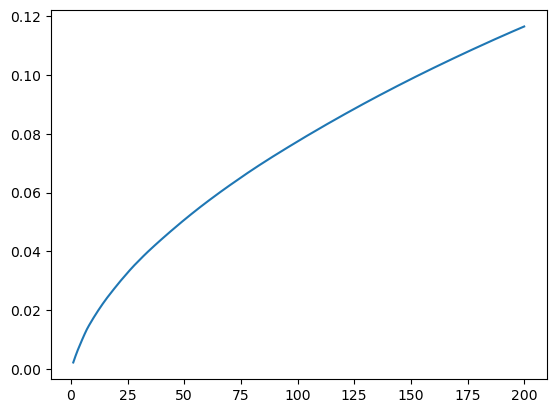

In [90]:
pd.Series(svd_playlists_test.explained_variance_ratio_.cumsum(),index=range(1,201)).plot()

In [23]:
# Create an empty DataFrame with columns as unique song IDs
one_hot_vectors = pd.DataFrame(columns=df.index, index=train_songs.index)

def get_one_hot_vector(songs):
    one_hot_vector = pd.Series(0, index=df.index)
    one_hot_vector.loc[songs] = 1
    return one_hot_vector 

one_hot_vectors = one_hot_vectors.progress_apply(lambda x: get_one_hot_vector(train_songs.loc[x.name]['songs']), axis=1)


svd_playlists = TruncatedSVD(n_components=50)
one_hot_vectors_svd = svd_playlists.fit_transform(one_hot_vectors)
one_hot_vectors = None

  0%|          | 0/4856 [00:00<?, ?it/s]

In [40]:
import pickle
pickle.dump(svd_playlists, open('models/svd_playlists.pkl', 'wb'))

In [41]:
pd.DataFrame(one_hot_vectors_svd, index=train_songs.index).to_csv('data/playlist_svd.csv')

In [25]:
u_cf = build_ann(pd.DataFrame(one_hot_vectors_svd), 'models/cf_annoy.ann', dist_metric='angular', fit=True)

In [26]:
def get_recommendations_purecf(songs, u, playlists, n=10):
    one_hot_songs_test = get_one_hot_vector(songs).values.reshape(1,-1)
    one_hot_songs_test_svd = svd_playlists.transform(one_hot_songs_test)
    idx = u.get_nns_by_vector(one_hot_songs_test_svd[0], n*3)
    return playlists.iloc[idx]['songs'].explode().value_counts().head(n).index.tolist()

In [27]:
train_songs.to_csv('data/train_songs.csv')

In [28]:
df.loc[get_recommendations_purecf(songs_test, u_cf, train_songs, n=10),['name','artists_names','artists_genres']]

/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(


,name,artists_names,artists_genres
track_uri,,,
spotify:track:5xTtaWoae3wi06K5WfVUUH,Shake It Off,[Taylor Swift],[[pop]]
spotify:track:1u8c2t2Cy7UBoG4ArRcF5g,Blank Space,[Taylor Swift],[[pop]]
spotify:track:1R0a2iXumgCiFb7HEZ7gUE,Don’t Blame Me,[Taylor Swift],[[pop]]
spotify:track:10GJQkjRJcZhGTLagFOC62,Most Girls,[Hailee Steinfeld],"[[dance pop, pop, post-teen pop]]"
spotify:track:1yvMUkIOTeUNtNWlWRgANS,Unstoppable,[Sia],"[[australian dance, australian pop, dance pop,..."
spotify:track:4esOae7i4rqTbAu9o5Pxco,Girl on Fire,[Alicia Keys],"[[hip pop, neo soul, pop, r&b, urban contempor..."
spotify:track:05GsNucq8Bngd9fnd4fRa0,Begin Again (Taylor's Version),[Taylor Swift],[[pop]]
spotify:track:42ydLwx4i5V49RXHOozJZq,Scars To Your Beautiful,[Alessia Cara],"[[canadian contemporary r&b, canadian pop, dan..."
spotify:track:4cluDES4hQEUhmXj6TXkSo,What Makes You Beautiful,[One Direction],"[[boy band, pop, post-teen pop, talent show]]"


In [29]:
y_pred_purecf = pd.DataFrame(X_test).apply(lambda x: get_recommendations_purecf(x.tolist(), u_cf, train_songs, n=10), axis=1)

/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarnin

In [30]:
sum(calculate_overlap(yp, yt) for yp, yt in zip(y_pred_purecf, y_test)) / len(y_test)

3.165

In [72]:
from scipy.spatial.distance import cdist

# Calculate the angular distance

def get_recommendations_hybrid(songs, u_cf, final_embedding, one_hot_vectors_svd, n=10, how='score', multiplier=1):
    one_hot_songs_test = get_one_hot_vector(songs).values.reshape(1,-1)
    one_hot_songs_test_svd = svd_playlists.transform(one_hot_songs_test)
    idx = u_cf.get_nns_by_vector(one_hot_songs_test_svd[0], n*multiplier)
    all_candidate_songs =  train_songs.iloc[idx]['songs'].explode()
    all_candidate_songs = all_candidate_songs.reset_index().set_index('songs')
    if how == 'freq':
        all_candidate_songs = all_candidate_songs[~all_candidate_songs.index.isin(songs)]
        return pd.Series(all_candidate_songs.index).value_counts().head(n).index.tolist()
    angular_distances = cdist(one_hot_vectors_svd[idx], 
                            one_hot_songs_test_svd, metric='cosine')
    playlist_dist = pd.Series(angular_distances.flatten(),index =  train_songs.iloc[idx].index)
    all_candidate_songs = all_candidate_songs.merge(playlist_dist.map(lambda x: 1/(x+0.0001)).rename('score'), left_on = ['index'], right_index= True, how='left')
    all_candidate_songs = all_candidate_songs.groupby(all_candidate_songs.index).sum()
    all_candidate_songs = all_candidate_songs.sort_values(by='score', ascending=False)
    all_candidate_songs = all_candidate_songs[~all_candidate_songs.index.isin(songs)]
    if how == 'score':
        return all_candidate_songs.head(n).index.tolist()
    if how == 'weighted':
        all_candidate_songs =  train_songs.iloc[idx]['songs'].explode()
        song_distances = cdist(final_embedding.loc[all_candidate_songs], final_embedding.loc[songs], metric='cosine').mean(axis=1)
        song_distances = pd.Series(song_distances, index=all_candidate_songs)

        all_candidate_songs = all_candidate_songs.reset_index().merge(pd.DataFrame(playlist_dist, columns = ['playlist_dist']), left_on='index', right_index=True, how='left')
        final_songlist = all_candidate_songs.groupby('songs').apply(lambda x: x['playlist_dist'].fillna(1).prod())
        final_songlist = (final_songlist) / song_distances.drop_duplicates()
        final_songlist = final_songlist[~final_songlist.index.isin(songs)]
        final_songlist = final_songlist[~final_songlist.index.duplicated()]
        return final_songlist.sort_values(ascending=True).head(n).index.tolist()

In [48]:
df.loc[get_recommendations_hybrid(songs_test, u_cf, final_embedding, one_hot_vectors_svd, n=10, how='freq'),['name','artists_names','artists_genres']]

/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(


,name,artists_names,artists_genres
track_uri,,,
spotify:track:5xTtaWoae3wi06K5WfVUUH,Shake It Off,[Taylor Swift],[[pop]]
spotify:track:1yvMUkIOTeUNtNWlWRgANS,Unstoppable,[Sia],"[[australian dance, australian pop, dance pop,..."
spotify:track:1R0a2iXumgCiFb7HEZ7gUE,Don’t Blame Me,[Taylor Swift],[[pop]]
spotify:track:1u8c2t2Cy7UBoG4ArRcF5g,Blank Space,[Taylor Swift],[[pop]]
spotify:track:4esOae7i4rqTbAu9o5Pxco,Girl on Fire,[Alicia Keys],"[[hip pop, neo soul, pop, r&b, urban contempor..."
spotify:track:10GJQkjRJcZhGTLagFOC62,Most Girls,[Hailee Steinfeld],"[[dance pop, pop, post-teen pop]]"
spotify:track:7qEUFOVcxRI19tbT68JcYK,Everything Has Changed (feat. Ed Sheeran) (Tay...,[Taylor Swift],[[pop]]
spotify:track:05GsNucq8Bngd9fnd4fRa0,Begin Again (Taylor's Version),[Taylor Swift],[[pop]]
spotify:track:42ydLwx4i5V49RXHOozJZq,Scars To Your Beautiful,[Alessia Cara],"[[canadian contemporary r&b, canadian pop, dan..."


In [32]:
df.loc[get_recommendations_hybrid(songs_test, u_cf, final_embedding, one_hot_vectors_svd, n=10),['name','artists_names','artists_genres']]

/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(


,name,artists_names,artists_genres
track_uri,,,
spotify:track:1u8c2t2Cy7UBoG4ArRcF5g,Blank Space,[Taylor Swift],[[pop]]
spotify:track:5xTtaWoae3wi06K5WfVUUH,Shake It Off,[Taylor Swift],[[pop]]
spotify:track:04S1pkp1VaIqjg8zZqknR5,Enchanted,[Taylor Swift],[[pop]]
spotify:track:7qEUFOVcxRI19tbT68JcYK,Everything Has Changed (feat. Ed Sheeran) (Tay...,[Taylor Swift],[[pop]]
spotify:track:7lxADouiWFkwR7ZV2GKUcH,Back To December,[Taylor Swift],[[pop]]
spotify:track:1R0a2iXumgCiFb7HEZ7gUE,Don’t Blame Me,[Taylor Swift],[[pop]]
spotify:track:05GsNucq8Bngd9fnd4fRa0,Begin Again (Taylor's Version),[Taylor Swift],[[pop]]
spotify:track:2CYVETnhM9aytqrazYYwrK,Mr. Perfectly Fine (Taylor’s Version) (From Th...,[Taylor Swift],[[pop]]
spotify:track:6rZVy6FIG7lSJQMFXHo12z,New Romantics,[Taylor Swift],[[pop]]


In [73]:
df.loc[get_recommendations_hybrid(songs_test, u_cf, final_embedding, one_hot_vectors_svd, n=10, how='weighted'),['name','artists_names','artists_genres']]

/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(


,name,artists_names,artists_genres
track_uri,,,
spotify:track:3hUxzQpSfdDqwM3ZTFQY0K,august,[Taylor Swift],[[pop]]
spotify:track:05GsNucq8Bngd9fnd4fRa0,Begin Again (Taylor's Version),[Taylor Swift],[[pop]]
spotify:track:5mj69I4ygmIOEYuExJU9Cg,Buzz,[Vinyl Pinups],[[]]
spotify:track:6FT35oVqQZFiTPL9BLmHOH,Tayo Lang Ang May Alam,[Peryodiko],"[[pinoy indie, pinoy rock]]"
spotify:track:6fBNqDOZqAuLAN6fjCJXBM,Mr Porcelain,[Jude York],[[]]
spotify:track:4M36HQ9C5foLBAXhmFdP1X,let's be friends,[sammy rash],"[[gen z singer-songwriter, pop, sad rap]]"
spotify:track:04S1pkp1VaIqjg8zZqknR5,Enchanted,[Taylor Swift],[[pop]]
spotify:track:0mzfgAE2fKfzs8tNMI1W0Z,Waste,[Pablo Brooks],[[]]
spotify:track:3113Ux2drXauSunVHSPLgD,Ikaw Lang,[Kiyo],"[[opm, pinoy hip hop, tagalog rap]]"


In [76]:
y_pred_hybrid_freq = pd.DataFrame(X_test).apply(lambda x: get_recommendations_hybrid(x.tolist(), u_cf, final_embedding, one_hot_vectors_svd, n=10, how='freq'), axis=1)

/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarnin

In [74]:
y_pred_hybrid = pd.DataFrame(X_test).apply(lambda x: get_recommendations_hybrid(x.tolist(), u_cf, final_embedding, one_hot_vectors_svd, n=10), axis=1)
y_pred_hybrid_weighted = pd.DataFrame(X_test).apply(lambda x: get_recommendations_hybrid(x.tolist(), u_cf, final_embedding, one_hot_vectors_svd, n=10, how='weighted'), axis=1)

/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarnin

In [77]:
print(sum(calculate_overlap(yp, yt) for yp, yt in zip(y_pred_hybrid_freq, y_test)) / len(y_test))
print(sum(calculate_overlap(yp, yt) for yp, yt in zip(y_pred_hybrid, y_test)) / len(y_test))
print(sum(calculate_overlap(yp, yt) for yp, yt in zip(y_pred_hybrid_weighted, y_test)) / len(y_test))

4.345
8.33
6.655


In [54]:
freq_score = []
for i in range(1,11):
    y_pred_hybrid_freq = pd.DataFrame(X_test).apply(
        lambda x: get_recommendations_hybrid(
            x.tolist(),
            u_cf,
            final_embedding,
            one_hot_vectors_svd,
            n=10,
            how="freq",
            multiplier=i,
        ),
        axis=1,
    )
    freq_score.append(
        sum(calculate_overlap(yp, yt) for yp, yt in zip(y_pred_hybrid_freq, y_test))
        / len(y_test)
    )

/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarnin

<Axes: >

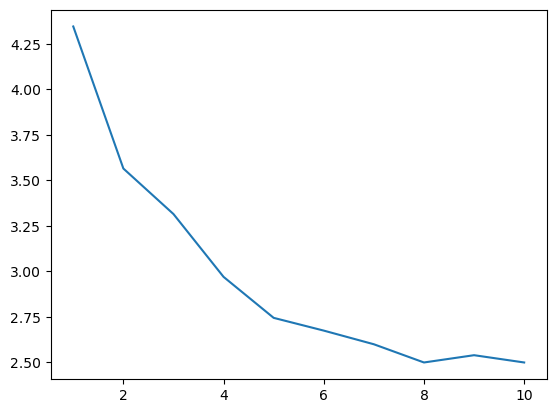

In [55]:
pd.Series(freq_score, index = range(1,11)).plot()

In [56]:
freq_score_score = []
for i in range(1,5):
    y_pred_hybrid_freq = pd.DataFrame(X_test).apply(
        lambda x: get_recommendations_hybrid(
            x.tolist(),
            u_cf,
            final_embedding,
            one_hot_vectors_svd,
            n=10,
            how="score",
            multiplier=i,
        ),
        axis=1,
    )
    freq_score_score.append(
        sum(calculate_overlap(yp, yt) for yp, yt in zip(y_pred_hybrid_freq, y_test))
        / len(y_test)
    )

/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarnin

ValueError: Length of values (4) does not match length of index (5)

<Axes: >

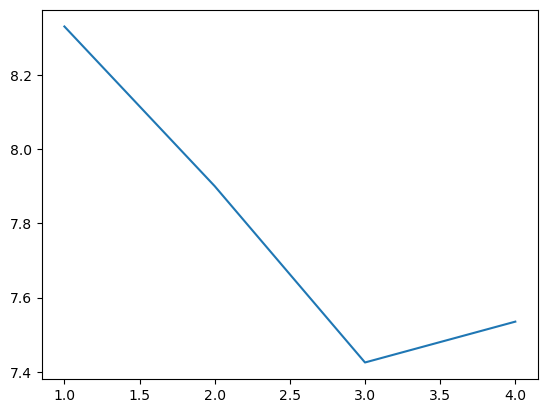

In [57]:
pd.Series(freq_score_score, index = range(1,5)).plot()

In [69]:
freq_score_weighted = []
for i in range(1,6):
    y_pred_hybrid_freq = pd.DataFrame(X_test).apply(
        lambda x: get_recommendations_hybrid(
            x.tolist(),
            u_cf,
            final_embedding,
            one_hot_vectors_svd,
            n=10,
            how="weighted",
            multiplier=i,
        ),
        axis=1,
    )
    freq_score_weighted.append(
        sum(calculate_overlap(yp, yt) for yp, yt in zip(y_pred_hybrid_freq, y_test))
        / len(y_test)
    )

/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but TruncatedSVD was fitted with feature names
  warnings.warn(
/Users/sy/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarnin

<Axes: >

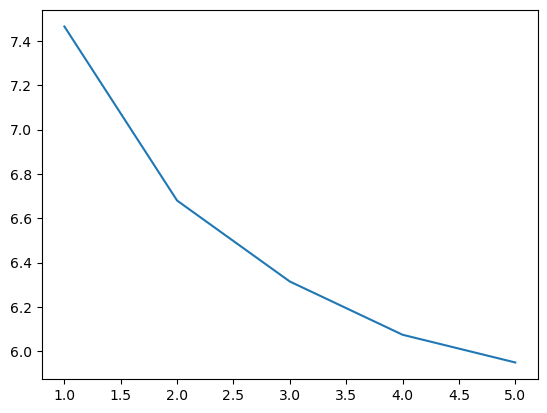

In [71]:
pd.Series(freq_score_weighted, index = range(1,6)).plot()

## Hybrid approaches with ML

In [6]:
train_songs.shape

(4856, 1)

In [7]:

X_train, y_train = create_test_set(train_songs, 30000, 5, 1, 1, random_state=42)

In [8]:
X_valid, y_valid = create_test_set(train_songs, 3000, 5, 1, 1, random_state=42)

In [9]:
import torch
import torch.nn as nn
import torch.optim as optim


In [10]:
if torch.backends.mps.is_available():
    device = torch.device("mps") #apple silicon
else:
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [11]:
class PlaylistRNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, num_layers=1):
        super(PlaylistRNN, self).__init__()
        self.rnn = nn.RNN(input_size=input_size, hidden_size=hidden_size, num_layers=num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        # x shape: (batch_size, seq_length, input_size)
        output, hidden = self.rnn(x)
        # We use the last hidden state to predict the next song embedding
        last_hidden = hidden[-1]
        prediction = self.fc(last_hidden)
        return prediction


In [12]:
import torch
from torch.utils.data import Dataset

class SongDataset(Dataset):
    def __init__(self, df_embedding, X_ids, y_ids):
        """
        df_embedding: DataFrame containing song embeddings.
        X_ids: Array of song IDs for input sequences (2D array where each row is a sequence of song IDs).
        y_ids: Array of song IDs for target songs (1D array).
        """
        self.df_embedding = df_embedding
        self.X_ids = X_ids
        self.y_ids = y_ids

    def __len__(self):
        return len(self.X_ids)

    def __getitem__(self, idx):
        X_song_ids = self.X_ids[idx]
        y_song_id = self.y_ids[idx]

        # Fetch embeddings for the input sequence
        X_embeddings = torch.tensor(self.df_embedding.loc[X_song_ids].values, dtype=torch.float32)
        
        # Fetch embedding for the target song and reshape to match the output of the model
        y_embedding = torch.tensor(self.df_embedding.loc[y_song_id].values, dtype=torch.float32)
        y_embedding = y_embedding.view(1, -1)  # Reshape from [17] to [1, 17]
        X_embeddings = X_embeddings.to(torch.float32)
        y_embedding = y_embedding.to(torch.float32)
        return X_embeddings, y_embedding



In [22]:
from torch.utils.data import DataLoader

# Assuming df_embedding, X_ids, and y_ids are already defined
dataset = SongDataset(final_embedding, np.array(X_train), np.array(y_train))
batch_size = 32

dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
val_dataloader = DataLoader(SongDataset(final_embedding, np.array(X_valid), np.array(y_valid)))
test_dataloader = DataLoader(SongDataset(final_embedding, np.array(X_test), np.array(y_test)))


In [23]:
# Parameters
input_size = final_embedding.shape[1] # Assuming each song embedding has 128 features
hidden_size = 50  # Can be adjusted
output_size = input_size  # Output should match the size of song embeddings
num_layers = 2  # Number of RNN layers

# Model, Loss, and Optimizer
model = PlaylistRNN(input_size, hidden_size, output_size, num_layers)
model.to(device)
criterion = nn.MSELoss()  # Mean Squared Error Loss for regression type problems
optimizer = optim.Adam(model.parameters(), lr=0.001)


In [24]:
def train_one_epoch(model, dataloader, optimizer, criterion):
    model.train()
    total_loss = 0
    for X_batch, y_batch in dataloader:
        X_batch, y_batch = X_batch.to(device), y_batch.to(device)
        optimizer.zero_grad()
        outputs = model(X_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()
        total_loss += loss.item() * X_batch.size(0)
    return total_loss / len(dataloader.dataset)

def validate(model, dataloader, criterion):
    model.eval()
    total_loss = 0
    with torch.no_grad():
        for X_batch, y_batch in dataloader:
            X_batch, y_batch = X_batch.to(device), y_batch.to(device)
            outputs = model(X_batch)
            loss = criterion(outputs, y_batch)
            total_loss += loss.item() * X_batch.size(0)
    return total_loss / len(dataloader.dataset)

n_epochs = 50
train_losses = []
val_losses = []
for epoch in tqdm(range(n_epochs)):
    train_loss = train_one_epoch(model, dataloader, optimizer, criterion)
    val_loss = validate(model, val_dataloader, criterion)
    train_losses.append(train_loss)
    val_losses.append(val_loss)
    print(f'Epoch {epoch + 1}/{n_epochs}, Training Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}')


  0%|          | 0/50 [00:00<?, ?it/s]

/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

Epoch 1/50, Training Loss: 606.0297, Validation Loss: 389.1993


/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

Epoch 2/50, Training Loss: 261.4930, Validation Loss: 169.0280


/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

Epoch 3/50, Training Loss: 122.1088, Validation Loss: 94.6183


/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

Epoch 4/50, Training Loss: 83.5031, Validation Loss: 80.6429


/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

Epoch 5/50, Training Loss: 78.0989, Validation Loss: 79.6577


/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

Epoch 6/50, Training Loss: 77.8240, Validation Loss: 79.6448


/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

Epoch 7/50, Training Loss: 77.8245, Validation Loss: 79.6459


/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

Epoch 8/50, Training Loss: 77.8189, Validation Loss: 79.6597


/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

Epoch 9/50, Training Loss: 77.8264, Validation Loss: 79.6407


/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

Epoch 10/50, Training Loss: 77.8309, Validation Loss: 79.6348


/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

Epoch 11/50, Training Loss: 77.8233, Validation Loss: 79.6339


/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

Epoch 12/50, Training Loss: 77.8257, Validation Loss: 79.6816


/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

Epoch 13/50, Training Loss: 77.8383, Validation Loss: 79.6593


/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

KeyboardInterrupt: 

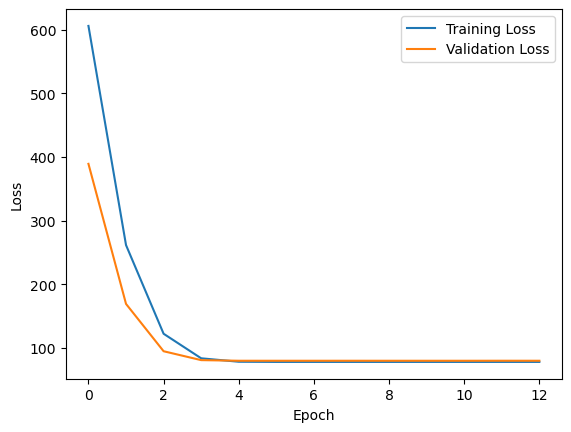

In [25]:
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

In [35]:
def get_recommendations_rnn(songs, u, model, df_embedding, df, n=10):
    model.eval()
    X_song_ids = songs
    X_embeddings = torch.tensor(df_embedding.loc[X_song_ids].values, dtype=torch.float32).unsqueeze(0)
    X_embeddings = X_embeddings.to(device)
    with torch.no_grad():
        prediction = model(X_embeddings)
    prediction = prediction.squeeze().cpu().numpy()
    idxs = u.get_nns_by_vector(prediction, n)
    recommend_id = df_embedding.iloc[idxs].index
    return recommend_id

In [36]:
songs_test = ['spotify:track:1D4PL9B8gOg78jiHg3FvBb','spotify:track:3tGq7hWDCtrnL83y5OGual','spotify:track:6K0CJLVXqbGMeJSmJ4ENKK','spotify:track:1n2wszmJyVkw6FHqyLnQsY','spotify:track:4OAuvHryIVv4kMDNSLuPt6','spotify:track:3kfgJql90tzgoxByioAMXR']

In [38]:
df.loc[get_recommendations_rnn(songs_test, u_cb, model, final_embedding, df, n=10)]

,name,artists_names,popularity,album_type,is_playable,release_date,artists_uris,playlist_uris,danceability,energy,...,valence,tempo,analysis_url,duration_ms,time_signature,artists_popularities,artists_genres,artists_followers,artists_genres_flat,artists_genres_flattened_list
track_uri,,,,,,,,,,,,,,,,,,,,,
spotify:track:16v2kDOVT04ffOYlaWiNkg,LSD Blues,[Various Artists],6,compilation,True,2014-10-23,[spotify:artist:0LyfQWJT6nXafLPZqxe9Of],[spotify:playlist:3PLl2h9e7jvujt87RHgUyq],0.337,0.668,...,0.5900,113.561,https://api.spotify.com/v1/audio-analysis/16v2...,283800.0,4.0,[0],[[]],[1873341],,[]
spotify:track:338rC2l0iYWhMnggeppXhM,Tränen,[DUNKL],39,single,True,2023-03-17,[spotify:artist:4kbN4pKuuLrvAj6X7FXM6A],[spotify:playlist:5ziwEqOT8A5sMPzIQbHE6P],0.813,0.556,...,0.2300,119.933,https://api.spotify.com/v1/audio-analysis/338r...,132000.0,4.0,[42],[[]],[3526],,[]
spotify:track:4o634Kk5r1q9iPWvUy8WB2,So Do I,[Various Artists],0,compilation,True,2013-03-05,[spotify:artist:0LyfQWJT6nXafLPZqxe9Of],[spotify:playlist:6vtWoue9S8OqrIfW8YuHoW],0.428,0.513,...,0.9340,176.440,https://api.spotify.com/v1/audio-analysis/4o63...,159707.0,4.0,[0],[[]],[1873341],,[]
spotify:track:5qsaBVoZcc7DZfIwkgZTfe,Can't Take It,[Lady Ocean],40,single,True,2018-12-12,[spotify:artist:6E4wyKIW6mC6zKaRgufLQn],[spotify:playlist:2zdvIGjWsQzgp2hGquTChc],0.808,0.489,...,0.5580,119.949,https://api.spotify.com/v1/audio-analysis/5qsa...,260000.0,4.0,[34],[[]],[5384],,[]
spotify:track:0gXboSv7b5cb2Q9YJzoLsV,Grown-Up Christmas List,[Various Artists],7,compilation,True,2018-12-07,[spotify:artist:0LyfQWJT6nXafLPZqxe9Of],[spotify:playlist:011GAmPrWChuoIT9eP8ryd],0.431,0.429,...,0.2080,120.242,https://api.spotify.com/v1/audio-analysis/0gXb...,258947.0,4.0,[0],[[]],[1873341],,[]
spotify:track:3ki9VcJ2jTwcI43Eb5INdP,Falling Sky,[Various Artists],0,compilation,True,2016-02-01,[spotify:artist:0LyfQWJT6nXafLPZqxe9Of],[spotify:playlist:54Cds8a8ps2Ae7obTa8Vgp],0.486,0.410,...,0.1850,127.780,https://api.spotify.com/v1/audio-analysis/3ki9...,237709.0,4.0,[0],[[]],[1873341],,[]
spotify:track:4dg50b80Y5vAGsYb2qceZk,Don't Tread On Me,[Various Artists],0,compilation,True,2009-06-01,[spotify:artist:0LyfQWJT6nXafLPZqxe9Of],[spotify:playlist:401HK96zS55kQUSEKoydzb],0.631,0.742,...,0.9130,130.825,https://api.spotify.com/v1/audio-analysis/4dg5...,166667.0,4.0,[0],[[]],[1873341],,[]
spotify:track:6kmYBYnSRYcY23sZnuZoLO,Wabi Sabi,[Various Artists],15,compilation,True,2021-02-12,[spotify:artist:0LyfQWJT6nXafLPZqxe9Of],[spotify:playlist:1FrxRL7jOIdSuAg5HjQJuV],0.347,0.618,...,0.0662,129.988,https://api.spotify.com/v1/audio-analysis/6kmY...,276923.0,4.0,[0],[[]],[1873341],,[]
spotify:track:4NCQqycLdREaex1BE3eYx8,SPOOKY SCARY SKELETONS - Dugzy REMIX,[Various Artists],7,single,True,2021-10-06,[spotify:artist:0LyfQWJT6nXafLPZqxe9Of],[spotify:playlist:3gVdD8LOaw4IuOWSdtYobL],0.650,0.592,...,0.1420,150.051,https://api.spotify.com/v1/audio-analysis/4NCQ...,164800.0,4.0,[0],[[]],[1873341],,[]


In [39]:
scores = []
for i in range(len(X_test)):
    y_pred = get_recommendations_rnn(X_test[i], u_cb, model, final_embedding, df, n=10)
    scores.append(calculate_overlap(y_pred, y_test[i]))

In [40]:
np.mean(scores)

0.0

In [41]:
class ExtendedSongDataset(Dataset):
    def __init__(self, df_embedding, X_ids, y_ids, get_recommendations_cb, u_cb):
        self.df_embedding = df_embedding
        self.X_ids = X_ids
        self.y_ids = y_ids
        self.get_recommendations_cb = get_recommendations_cb
        self.u_cb = u_cb

    def __len__(self):
        return len(self.X_ids)

    def __getitem__(self, idx):
        X_song_ids = self.X_ids[idx]
        y_song_id = self.y_ids[idx]
        df_embedding = self.df_embedding
        u_cb = self.u_cb
        # Initialize an empty tensor for concatenated embeddings
        X_embeddings = torch.empty(0, 11 * self.df_embedding.shape[1])

        # Fetch and concatenate embeddings for each song and its recommendations
        for song_id in X_song_ids:
            song_embedding = self.df_embedding.loc[song_id].values
            recommendations = self.get_recommendations_cb(song_id, u_cb, df_embedding, n=10)
            recommendation_embeddings = self.df_embedding.loc[recommendations].values.flatten()
            full_embedding = np.concatenate((song_embedding, recommendation_embeddings))
            X_embeddings = torch.cat((X_embeddings, torch.tensor(full_embedding).unsqueeze(0)), dim=0)

        y_embedding = torch.tensor(self.df_embedding.loc[y_song_id].values, dtype=torch.float32)
        X_embeddings = X_embeddings.to(torch.float32)
        y_embedding = y_embedding.to(torch.float32)
        return X_embeddings, y_embedding


In [42]:
class PlaylistRNNFromRecommends(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, num_layers=1):
        super(PlaylistRNNFromRecommends, self).__init__()
        self.rnn = nn.RNN(input_size=input_size, hidden_size=hidden_size, num_layers=num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        output, hidden = self.rnn(x)
        last_hidden = hidden[-1]
        prediction = self.fc(last_hidden)
        return prediction


In [43]:
input_size = 11 * final_embedding.shape[1]  # Adjusted input size
hidden_size = 256  # Can be tuned
output_size = final_embedding.shape[1]  # The dimensionality of the output embedding


model = PlaylistRNNFromRecommends(input_size, hidden_size, output_size, num_layers=2)
model.to(device)

PlaylistRNNFromRecommends(
  (rnn): RNN(187, 256, num_layers=2, batch_first=True)
  (fc): Linear(in_features=256, out_features=17, bias=True)
)

In [44]:
train_dataset = ExtendedSongDataset(final_embedding, X_train, y_train, get_recommendations_cb, u_cb)
val_dataset = ExtendedSongDataset(final_embedding, X_train, y_train, get_recommendations_cb, u_cb)
test_dataset = ExtendedSongDataset(final_embedding, X_test, y_test, get_recommendations_cb, u_cb)
train_dataloader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=32)
test_dataloader = DataLoader(test_dataset, batch_size=32)


In [45]:

criterion = nn.MSELoss()  # Mean Squared Error Loss for regression type problems
optimizer = optim.Adam(model.parameters(), lr=0.001)


In [46]:
n_epochs = 50
train_losses = []
val_losses = []
for epoch in tqdm(range(n_epochs)):
    train_loss = train_one_epoch(model, train_dataloader, optimizer, criterion)
    val_loss = validate(model, val_dataloader, criterion)
    train_losses.append(train_loss)
    val_losses.append(val_loss)
    print(f'Epoch {epoch + 1}/{n_epochs}, Training Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}')


  0%|          | 0/50 [00:00<?, ?it/s]

/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

Epoch 1/50, Training Loss: 217.9364, Validation Loss: 78.1291


/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

Epoch 2/50, Training Loss: 77.8740, Validation Loss: 77.8468


/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

Epoch 3/50, Training Loss: 77.8778, Validation Loss: 77.8281


/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

Epoch 4/50, Training Loss: 77.9007, Validation Loss: 77.9933


/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

Epoch 5/50, Training Loss: 77.8759, Validation Loss: 77.8233


/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/sy/anaconda3/lib/python3.11/site-packages/torch/nn/modules/loss.py:535: UserWarning: Using a target size (torch.Size([32, 1, 17])) that is different to the input size (torch.Size([32, 17])). This will likely lead to incorrect results due to broadcasting. Please ensure 

KeyboardInterrupt: 

In [54]:
def get_recommendations_rnn_from_recommend(songs, u, model, df_embedding, n=10):
    model.eval()
    X_song_ids = songs
    X_embeddings = torch.empty(0, 11 * df_embedding.shape[1])
    for song_id in X_song_ids:
        song_embedding = df_embedding.loc[song_id].values
        recommendations = get_recommendations_cb(song_id, u, df_embedding, n=10)
        recommendation_embeddings = df_embedding.loc[recommendations].values.flatten()
        full_embedding = np.concatenate((song_embedding, recommendation_embeddings))
        X_embeddings = torch.cat((X_embeddings, torch.tensor(full_embedding).unsqueeze(0)), dim=0)

    #X_embeddings = torch.tensor(df_embedding.loc[X_song_ids].values, dtype=torch.float32).unsqueeze(0)
    X_embeddings = X_embeddings.to(torch.float32)
    X_embeddings = X_embeddings.to(device)
    with torch.no_grad():
        prediction = model(X_embeddings)
    prediction = prediction.squeeze().cpu().numpy()
    idxs = u.get_nns_by_vector(prediction, n)
    recommend_id = df_embedding.iloc[idxs].index
    return recommend_id

In [57]:
scores = []
for i in range(len(X_test)):
    y_pred = get_recommendations_rnn_from_recommend(X_test[i], u_cb, model, final_embedding, n=10)
    scores.append(calculate_overlap(y_pred, y_test[i]))
np.mean(scores)

0.01

In [70]:
import regex as re

df_name_artist_id = df[['name', 'artists_names']].reset_index()
df_name_artist_id['name_artist'] = df_name_artist_id['name'] + ' - ' + df_name_artist_id['artists_names'].apply(lambda x: ', '.join(x))
df_name_artist_id = df_name_artist_id.drop(columns=['name', 'artists_names'])
def search_df(searchterm: str,df: pd.DataFrame):
    if not searchterm:
        return []
    keywords = searchterm.lower().split()
    pattern = '|'.join([f'(?=.*{keyword})' for keyword in keywords])

    result = df[df['name_artist'].str.lower().str.contains(pattern, flags=re.IGNORECASE, regex=True, na=False)]
    print(result)
    return []


In [71]:
search_df('hello',df_name_artist_id)

                                   track_uri  \
126     spotify:track:0TgaaBAEf84VqvdTshIdPw   
676     spotify:track:1pXtUVmSS3Aky3j6nQ4sQT   
2366    spotify:track:7v8YDCoM60xCPuSbXerImD   
2373    spotify:track:21AUdfi6fLFDp9JuNcHsfS   
3229    spotify:track:3tHm0NnzLiQsaMUkJNcAij   
...                                      ...   
274440  spotify:track:1gvGEGyC3rmJ60XMejfM2T   
275392  spotify:track:0mHyWYXmmCB9iQyK18m3FQ   
275560  spotify:track:2c62Xf5Po1YSa1N6LOjPHy   
276203  spotify:track:2E7OvE073ENQi8KzwTKPcz   
276993  spotify:track:1MDoll6jK4rrk2BcFRP5i7   

                                              name_artist  
126                     Cold Is The Night - The Oh Hellos  
676                                Hello - The Cat Empire  
2366                       Hello Stranger - Barbara Lewis  
2373                            Hello, World - Louie Zong  
3229    Hello Baby feat. Fivio Foreign - Young M.A, Fi...  
...                                                   ...  
274

[]

In [60]:
df[['danceability',
       'energy', 'key', 'loudness', 'speechiness', 'acousticness',
       'instrumentalness', 'liveness', 'valence', 'tempo']]

,danceability,energy,key,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo
track_uri,,,,,,,,,,
spotify:track:3v6sBj3swihU8pXQQHhDZo,0.611,0.614,5.0,-8.815,0.0672,0.01690,0.000794,0.7530,0.520,128.050
spotify:track:7KCWmFdw0TzoJbKtqRRzJO,0.638,0.781,4.0,-6.848,0.0285,0.01180,0.009530,0.3490,0.250,122.985
spotify:track:2CY92qejUrhyPUASawNVRr,0.560,0.810,0.0,-8.029,0.0872,0.00710,0.000008,0.2410,0.247,170.044
spotify:track:11BPfwVbB7vok7KfjBeW4k,0.525,0.699,9.0,-4.571,0.0353,0.01780,0.000088,0.0888,0.199,92.011
spotify:track:3yUJKPsjvThlcQWTS9ttYx,0.367,0.771,9.0,-5.863,0.1060,0.36500,0.000001,0.0965,0.163,115.917
...,...,...,...,...,...,...,...,...,...,...
spotify:track:6wLr2oR8eqUG5Beleh2Crm,0.777,0.725,5.0,-9.012,0.0470,0.12600,0.010800,0.0917,0.851,128.349
spotify:track:5mYtpXrZZ1bbGJYDGC8I0Y,0.543,0.482,4.0,-12.789,0.1940,0.08530,0.000092,0.1110,0.415,193.513
spotify:track:7FwBtcecmlpc1sLySPXeGE,0.527,0.942,1.0,-5.640,0.0366,0.01150,0.000000,0.1880,0.495,148.723
